In [1]:
import scanpy as sc 
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colors, cm
import numpy as np
import os

from var import *

In [2]:
#set seed to 0 for reproducibility of results
np.random.seed(0)

In [3]:
#define which dataset to use
dataset = '49_03_l1_crispra_5_gex'

In [4]:
#Create figures folder
figures_folder = os.path.join(results_folder, f'figures/{dataset}/cell_state/')
if not os.path.exists(figures_folder):
    os.makedirs(figures_folder)

## 1. Evaluate heterogeneous cell state response

In [5]:
#load log normalised adata object with filter for cells with more than 5000 UMI counts expressed
adata_preprocessed = sc.read_h5ad(f'/lustre/scratch123/hgi/teams/parts/kl11/cell2state_tf_activation/results/20230306_adata_49_04_l3_3_wt_gex_guide_assigned.h5ad')
#filter out cells that are not in the perturbation state
adata_perturbed = adata_preprocessed[adata_preprocessed.obs['pert_state'] != 'not_perturbed']

In [6]:
#load experimental design
experimental_design = pd.read_csv('/lustre/scratch123/hgi/teams/parts/kl11/cell2state_tf_activation/data/49_03_exp_design_20221124 - Sheet1.csv')

In [7]:
#function pivot experimental design data from wide to long format
def pivot_experimental_design(df):
    '''
    Pivot experimental design data from wide to long format with data wrangling to match barcode count data

    Parameters
    ----------
    df : pd.DataFrame
        DataFrame containing the experimental design data
    Returns
    -------
    df_long : pd.DataFrame
        DataFrame containing the experimental design data in long format
        
    '''
    # create index by merging all columns containing pertubation in column name
    df['perturbation'] = df.filter(regex='perturbation').apply(lambda x: '_'.join(x.dropna().astype(str)), axis=1)
    # drop double control condition by dropping duplicates
    df = df.drop_duplicates(subset='perturbation', keep='first')
    #convert all columns header to string
    df.columns = df.columns.astype(str)

    # pivot experimental design data from wide to long format drop variable column
    guide_col=df.columns[df.columns.str.startswith('guide')]
    df_long = pd.melt(df, id_vars=['perturbation','number_of_pert'], value_vars=guide_col, var_name='guide_no', value_name='guide')
    df_long = df_long.drop(columns=['guide_no'])
    # sort rows by perturbation
    df_long = df_long.sort_values(by=['perturbation'])
    # drop all nan columns in guide column
    df_long = df_long.dropna(subset=['guide'])
    #in grna column replace regex r'+\d+' with ''
    df_long['guide'] = df_long['guide'].str.replace(r'\+.+', '', regex=True)
    #create a columns with target gene name by splitting guide column on '_'
    df_long['guide_target_gene'] = df_long['guide'].str.split('_gRNA').str[0]
    df_long['guide_target_gene'] = df_long['guide_target_gene'].str.split('_gRNA').str[0]
    # #for CONTROL condition set target gene to 'CONTROL'
    # df_long.loc[df_long['perturbation'] == 'CONTROL', 'guide_target_gene'] = 'CONTROL'

    return df_long

In [8]:
experimental_design_long = pivot_experimental_design(experimental_design)

In [9]:
#from experimental design long extract target genes uniquely from guide_target_gene column and exclude CONTROL
experimental_design_long = experimental_design_long[experimental_design_long['perturbation'] != 'CONTROL']
target_genes = experimental_design_long['guide_target_gene'].unique()

#check if target genes are in adata var SYMBOL column
target_genes_in_adata = [gene for gene in target_genes if gene in adata_preprocessed.var['SYMBOL'].tolist()]


In [10]:
target_genes_in_adata

['AIRE',
 'ASCL1',
 'DLX1',
 'IRF3',
 'LHX6',
 'MAFB',
 'MYOD1',
 'NEUROG2',
 'OLIG2',
 'PROX1',
 'RORA',
 'RORB',
 'SATB2']

### 1.1 Target gene vs. guide count correlation

In [12]:
#calculate layer with log1p corrected counts
adata_perturbed.layers['log1p'] = np.log1p(adata_perturbed.layers['counts'])

['AIRE_ACAGCAGCGCCTCCATCACA_AIRE_CGGAGACTTCCCGAGAGCGA_1', 'AIRE_ACAGCAGCGCCTCCATCACA_AIRE_CGGAGACTTCCCGAGAGCGA_2', 'AIRE_ATCACAGGGAAGTGTCCCTG_AIRE_CAGGGAAGTGTCCCTGCGGG_1', 'AIRE_ATCACAGGGAAGTGTCCCTG_AIRE_CAGGGAAGTGTCCCTGCGGG_2']
['ASCL1_AGCCGCTCGCTGCAGCAGCG_ASCL1_GGAGGGGGAGTTTAGGGAGT_1', 'ASCL1_AGCCGCTCGCTGCAGCAGCG_ASCL1_GGAGGGGGAGTTTAGGGAGT_2', 'ASCL1_CTCCCCGCTGCTGCAGCGAG_ASCL1_GCAGCCGCTCGCTGCAGCAG_1', 'ASCL1_CTCCCCGCTGCTGCAGCGAG_ASCL1_GCAGCCGCTCGCTGCAGCAG_2']
['DLX1_AAAGCTTTGAACCGAGTTTG_DLX1_CCAGTGATTATGCAAGACAG_1', 'DLX1_AAAGCTTTGAACCGAGTTTG_DLX1_CCAGTGATTATGCAAGACAG_2', 'DLX1_GTGTGGATGCGTCTTACCCG_DLX1_TAAGACGCATCCACACTTCC_1', 'DLX1_GTGTGGATGCGTCTTACCCG_DLX1_TAAGACGCATCCACACTTCC_2']
['IRF3_CCGCCCTTTCTACGCTGGGC_IRF3_GTTTCCGGCCAGAGGCATGC_1', 'IRF3_CCGCCCTTTCTACGCTGGGC_IRF3_GTTTCCGGCCAGAGGCATGC_2', 'IRF3_CCGGCCCAGCGTAGAAAGGG_IRF3_TAACCGGCCCAGCGTAGAAA_1', 'IRF3_CCGGCCCAGCGTAGAAAGGG_IRF3_TAACCGGCCCAGCGTAGAAA_2']
['LHX6_ATGACTCATCTTGAACCGAG_LHX6_TCCCCCTCCAGCTGCAACGG_1', 'LHX6_ATGACTCATCTT

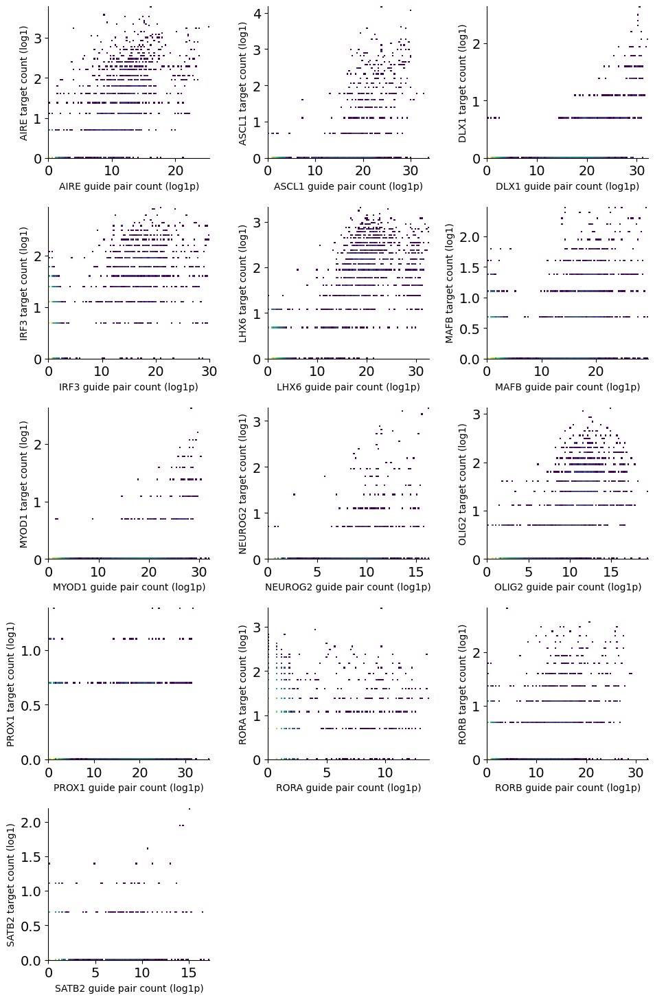

In [13]:
#plot scatter plot x axis UMI counts for perturbed cells and y axis target gene expression
rows = np.ceil(len(target_genes_in_adata)/3.0).astype(int)
fig, axs = plt.subplots(rows, 3, figsize=(10, rows*3))
#avoid overlap between subplots
fig.tight_layout(pad=3.0)


for i, short_name in enumerate(target_genes_in_adata):
    guides = adata_perturbed.obsm['guide_counts'].columns
    tmp_guides = guides[guides.str.contains(short_name)].tolist()
    print(tmp_guides)
    #check if tmp_guides are in adata obsm guide_counts columns
    tmp_guides = [guide for guide in tmp_guides if guide in adata_perturbed.obsm['guide_counts'].columns]
    #check if tmp_guides are in adta obsm guide_counts columns

    
    #change font size for all subplots
    for ax in fig.get_axes():
        ax.labelsize=14
        ax.tick_params(labelsize=14)
    
    
        
            
            
    tmp_pert = adata_perturbed.obsm['guide_counts'].loc[:,tmp_guides]
    #calculate log 1p of guide pair counts
    tmp_pert = np.log1p(tmp_pert)
    tmp_sum_perturbation = tmp_pert.sum(axis=1)
    #convert to matrix to array and reshape
    tmp_sum_perturbation = np.array(tmp_sum_perturbation).reshape(-1)

    #filter adata_perturbedrbed for counts of target gene based on short name
    #take the log1 of the counts
    tmp_target = adata_perturbed[:,adata_perturbed.var['SYMBOL'] == short_name].layers['log1p']
    #convert to array and reshape
    tmp_target = tmp_target.toarray().reshape(-1)

    
    axs[divmod(i,3)].hist2d(tmp_sum_perturbation,tmp_target,bins=100,density=True, 
                    norm = colors.LogNorm())

    #add x and y label
    axs[divmod(i,3)].set_xlabel(f'{short_name} guide pair count (log1p)')
    axs[divmod(i,3)].set_ylabel(f'{short_name} target count (log1)')
    
        

#remove empty subplots
for i in range(len(target_genes_in_adata), rows*3):
    fig.delaxes(axs[divmod(i,3)])

#save figure
#fig.savefig(os.path.join(figures_folder, f'{today}_guide_pair_v_target_gene_count.pdf'), dpi=300, bbox_inches='tight')

In [ ]:
adata_perturbed.obsm['guide_counts'].columns

In [ ]:
#subset adata for each perturbation state by looping
guides = adata_perturbed.var_names.str.rstrip('_1|_2').unique()
#create subfolder in figures folder to store figures if it does not exist
target_gene_expression_folder = os.path.join(figures_folder, 'guide_pair_v_target_gene_count')
if not os.path.exists(target_gene_expression_folder):
    os.makedirs(target_gene_expression_folder)

for pert in experimental_design_long['perturbation'].unique():
    #split perturbation name on '_' and take first element
    single_pert = pert.split('_')
    #add to each string in pert ^ and $ to match the whole string
    regex_pert = [f'^{x}$' for x in single_pert]
    #create regex to match perturbation name
    regex_pert = '|'.join(regex_pert)

    #map pert to var_names using .var
    tmp_target= adata_perturbed[:,adata_perturbed.var['SYMBOL'].str.contains(regex_pert)].var['SYMBOL'].to_list()

    #create subplots 
    fig, axs = plt.subplots(1,2, figsize=(10,5))

    #subset adata_perturbed for each perturbation state and control
    print(tmp_target+['CONTROL'])
    #filter for rows where pert_state is CONTROL or tmp_target

    
    tmp_adata = adata_perturbed[adata_perturbed.obs['pert_state'].isin([pert,'CONTROL'])]
    


    #plot UMAP for target gene expression and perturbation state
    sc.pl.umap(tmp_adata, color=tmp_target, show=False,title=pert,gene_symbols='SYMBOL',ax=axs[0],cmap='RdPu')
    sc.pl.umap(tmp_adata, color='pert_state', show=False,ax=axs[1])

        # #save figure
        # fig.savefig(os.path.join(target_gene_expression_folder, f'{today}_{pert}_UMAP.pdf'), dpi=300, bbox_inches='tight')
            


### 1.2 Explore loss of stemness in perturbed cells

In [ ]:
#plot pluripotency marker genes in umap
#marker list based on https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6028138/#!po=13.4615
sc.pl.umap(adata_preprocessed, color=['NANOG','SOX2','KLF4','POU5F1','DNMT3B','NODAL','UTF1','LEFTY2'],gene_symbols='SYMBOL',cmap='RdPu',show=False)
# #save umap plot
# plt.savefig(os.path.join(figures_folder, f'{today}_cell_cycle_wo_reg_pluripotency_markers.pdf'), dpi=300, bbox_inches='tight')

### 1.3 Cofactor analysis

In [ ]:
# load cofactor csv as pandas dataframe
cofactor_df = pd.read_csv('/lustre/scratch123/hgi/teams/parts/kl11/cell2state_tf_activation/data/cofactor_functionality.csv')
cofactor_df['cofactors'] = cofactor_df['cofactors'].str.replace(r"\s+",'',regex=True)

#all capital letter
cofactor_df['cofactors'] = cofactor_df['cofactors'].str.upper()

In [ ]:
cofactor_df['functionality'].unique()

In [ ]:
#plot cofactor in umap of adatapreprocessed
for func in cofactor_df['functionality'].unique():
    tmp_cofactors = cofactor_df[cofactor_df['functionality']==func]['cofactors'].to_list()
    print(tmp_cofactors)
    #filter for only cofactors found in adatapreprocessed SYMBOL
    tmp_cofactors = [x for x in tmp_cofactors if x in adata_perturbed.var['SYMBOL'].to_list()]
    print(len(tmp_cofactors))
    #exclude SATB2 pertubation state due to its low abundance
    adata_perturbed = adata_perturbed[adata_perturbed.obs['pert_state']!='SATB2']
    if len(tmp_cofactors)>0:
        #plot UMAP for all tmp_cofactors
        ax=sc.pl.umap(adata_perturbed, color=tmp_cofactors, show=False,gene_symbols='SYMBOL',cmap='RdPu')
        
        # ax=sc.pl.dotplot(adata_perturbed, tmp_cofactors, groupby='perturbation_state',gene_symbols='SYMBOL',cmap='viridis',show=False)

        # #add x and y label
        # ax['mainplot_ax'].set_xlabel(f'{func} cofactors')
        # ax['mainplot_ax'].set_ylabel('perturbation state')

        #string replace for saving figure
        func = func.replace(' ','_')
        func = func.replace('/','_')
        
        #save umap plot
        plt.savefig(os.path.join(figures_folder, f'{today}_{func}_cofactor_analysis.pdf'), dpi=300, bbox_inches='tight')
